<a href="https://colab.research.google.com/github/elsoori/CropDoc/blob/main/cropdocday2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -Uqq fastai duckduckgo_search fastbook timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 22.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.7/75.7 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 58.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.6/519.6 kB 27.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 57.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.9/294.9 kB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 49.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.0/76.0 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 67.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
from duckduckgo_search import ddg_images
from fastcore.all import *
from fastai.vision.all import *
from fastbook import *
from fastai.vision.widgets import *
from fastcore.all import *
import timm
from fastdownload import download_url
from time import sleep

In [3]:
from google.colab import drive
drive.mount('/content/hackfinal', force_remount=True)

Mounted at /content/hackfinal


In [5]:
def search_images( term, max_images=100):
    print(f"Searching for '{term}'")
    return L(ddg_images(term, max_results=max_images)).itemgot('image')


In [6]:
disease_types = 'Brown Spot','Bacterial Blight', 'Bacterial Pustule','Frogeye Leaf Spot', 'Cercospora Leaf Blight','Downy Mildew', 'Healthy Soybean Leaf'

path = Path('soycrop')
from time import sleep

for o in disease_types:
    dest = (path/o)
    dest.mkdir(exist_ok=True, parents =True)
    download_images(dest, urls=search_images(f'{o} in Soybean plant'))
    sleep(1)

    resize_images(path/o, max_size=200, dest=path/o)

Searching for 'Brown Spot in Soybean plant'


/usr/local/lib/python3.10/dist-packages/duckduckgo_search/compat.py:60: UserWarning: ddg_images is deprecated. Use DDGS().images() generator
  warnings.warn("ddg_images is deprecated. Use DDGS().images() generator")
/usr/local/lib/python3.10/dist-packages/duckduckgo_search/compat.py:64: UserWarning: parameter page is deprecated
  warnings.warn("parameter page is deprecated")
/usr/local/lib/python3.10/dist-packages/duckduckgo_search/compat.py:66: UserWarning: parameter max_results is deprecated
  warnings.warn("parameter max_results is deprecated")


Searching for 'Bacterial Blight in Soybean plant'
Searching for 'Bacterial Pustule in Soybean plant'


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Searching for 'Frogeye Leaf Spot in Soybean plant'
Searching for 'Cercospora Leaf Blight in Soybean plant'
Searching for 'Downy Mildew in Soybean plant'


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Searching for 'Healthy Soybean Leaf in Soybean plant'


In [7]:
failed = verify_images(get_image_files(path))
failed.map(Path.unlink)
len(failed)

13

In [9]:
soycrop = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(192))

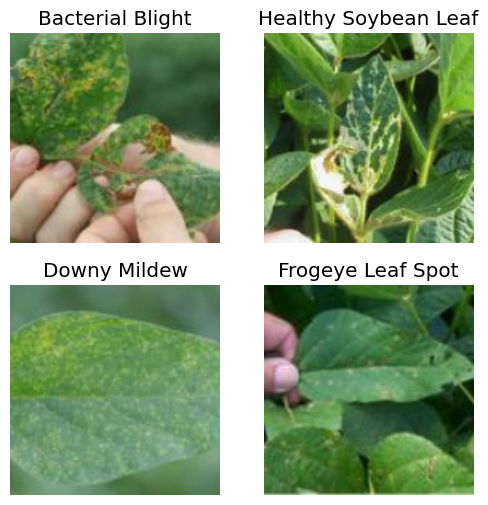

In [10]:
dls = soycrop.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=2)

In [11]:
soycrop = soycrop.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = soycrop.dataloaders(path)

In [12]:
learn = vision_learner(dls,'convnextv2_nano', metrics=error_rate).to_fp16()
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,3.084182,2.023859,0.660870,00:06


epoch,train_loss,valid_loss,error_rate,time
0,2.381134,1.775395,0.600000,00:03
1,2.218195,1.851569,0.573913,00:03
2,2.025142,1.689321,0.530435,00:02
3,1.893410,1.635314,0.547826,00:02


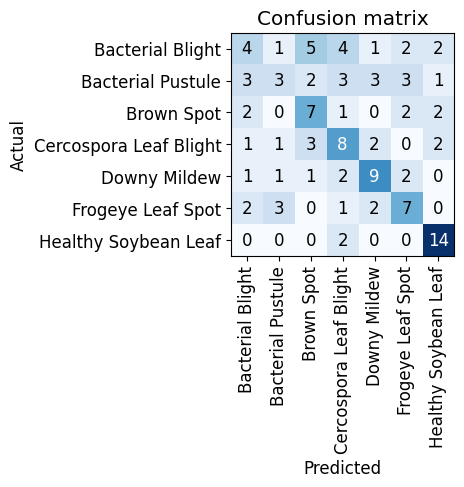

In [14]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [16]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [17]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

In [23]:
learn = vision_learner(dls,'convnextv2_nano', metrics=error_rate).to_fp16()
learn.fine_tune(6)


epoch,train_loss,valid_loss,error_rate,time
0,3.024525,2.197208,0.643478,00:03


epoch,train_loss,valid_loss,error_rate,time
0,2.470659,1.907325,0.617391,00:03
1,2.241702,1.754171,0.608696,00:02
2,2.092494,1.832399,0.573913,00:02
3,1.949058,1.785161,0.539130,00:02
4,1.809488,1.740995,0.521739,00:02
5,1.721793,1.744232,0.530435,00:03


In [24]:
learn.export('modelbest1final.pkl')